<a href="https://colab.research.google.com/github/sobhanshukueian/FCN-semantic-segmentation/blob/main/FCN_semantic.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# FCN Semantic Segmentation
One of the Semantic segmentation algorithms is FCN that uses a Fully Convolutional Network (FCN) i.e. you stack a bunch of convolutional layers in a encoder-decoder fashion. The encoder downsamples the image using strided convolution giving a compressed feature representation of the image, and the decoder upsamples the image using methods like transpose convolution to give the segmented output

[Paper Link](https://arxiv.org/abs/1411.4038)

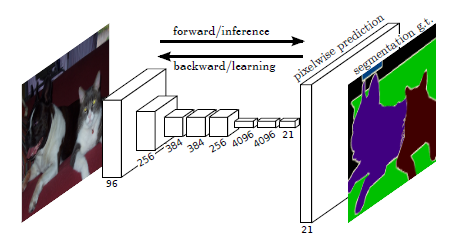

One major issue with in-network Downsampling in a FCN is that it reduces the resolution of the input by a large factor, thus during upsampling it becomes very difficult to reproduce the finer details even after using sophisticated techniques like Transpose Convolution. As a result we obtain a coarse output (refer the illustration below).
One-way to deal with this is by adding ‘skip connections’ in the Upsampling stage from earlier layers and summing the two feature maps. These skip connections provide enough information to later layers to generate accurate segmentation boundaries.  This combination of fine and coarse layers leads to local predictions with nearly accurate global (spatial) structure.  
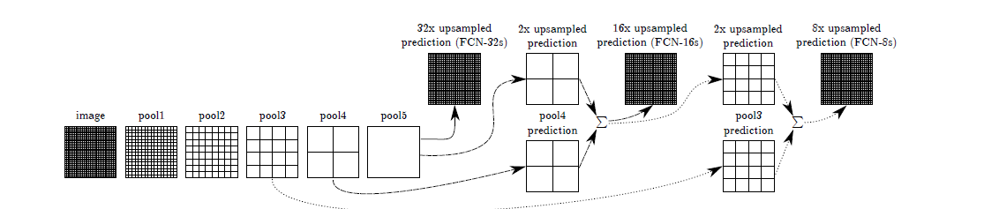


#CamVid Dataset 
CamVid (Cambridge-driving Labeled Video Database) is a road/driving scene understanding database which was originally captured as five video sequences with a 960×720 resolution camera mounted on the dashboard of a car. Those sequences were sampled (four of them at 1 fps and one at 15 fps) adding up to 701 frames.
You Can Dowload dataset from kaggle:

[Download Dataset from Kaggle](https://www.kaggle.com/datasets/carlolepelaars/camvid)

## Some Configs for downloading from kaggle : 

1. Go to your account, Scroll to API section and Click Expire API Token to remove previous tokens
2. Click on Create New API Token - It will download kaggle.json file on your machine.


In [3]:
! pip install -q kaggle
! mkdir ~/.kaggle
#Upload the token json file 
from google.colab import files
files.upload()
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

Saving kaggle.json to kaggle.json
ref                                                            title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
iamsouravbanerjee/world-population-dataset                     World Population Dataset                             17KB  2022-08-31 11:20:04          11492        339  1.0              
pantanjali/unemployment-dataset                                Unemployment dataset                                 17KB  2022-09-08 08:26:10           3538         92  1.0              
harshsingh2209/tesla-stock-pricing-20172022                    TESLA stock pricing (2017-2022)                      28KB  2022-09-18 14:56:29            685         27  1.0              
thedevastator/airplane-crashes-

In [4]:
!kaggle datasets download -d carlolepelaars/camvid

 96% 553M/575M [00:21<00:01, 19.8MB/s]
100% 575M/575M [00:21<00:00, 27.6MB/s]


In [5]:
!unzip "camvid.zip"

Archive:  camvid.zip
  inflating: CamVid/class_dict.csv   
  inflating: CamVid/test/0001TP_006690.png  
  inflating: CamVid/test/0001TP_006720.png  
  inflating: CamVid/test/0001TP_006750.png  
  inflating: CamVid/test/0001TP_006780.png  
  inflating: CamVid/test/0001TP_006810.png  
  inflating: CamVid/test/0001TP_006840.png  
  inflating: CamVid/test/0001TP_006870.png  
  inflating: CamVid/test/0001TP_006900.png  
  inflating: CamVid/test/0001TP_006930.png  
  inflating: CamVid/test/0001TP_006960.png  
  inflating: CamVid/test/0001TP_006990.png  
  inflating: CamVid/test/0001TP_007020.png  
  inflating: CamVid/test/0001TP_007050.png  
  inflating: CamVid/test/0001TP_007080.png  
  inflating: CamVid/test/0001TP_007110.png  
  inflating: CamVid/test/0001TP_007140.png  
  inflating: CamVid/test/0001TP_007170.png  
  inflating: CamVid/test/0001TP_007200.png  
  inflating: CamVid/test/0001TP_007230.png  
  inflating: CamVid/test/0001TP_007260.png  
  inflating: CamVid/test/0001TP_007290.pn


#Import Dependencies and Configurations

In [6]:
# %matplotlib inline
import numpy as np
import random
from PIL import Image
import PIL.ImageOps    
import os
import shutil
import glob
import albumentations
import matplotlib.pyplot as plt

import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
import torchvision.utils
import torch
from torch.autograd import Variable
import torch.nn as nn
from torch import optim
import torch.nn.functional as F


In [7]:
DATASET_PATH = "/content/CamVid" #@param
train_images = glob.glob(f"{DATASET_PATH}/train/*")
train_images.sort()
train_segs = glob.glob(f"{DATASET_PATH}/train_labels/*")
train_segs.sort()
valid_images = glob.glob(f"{DATASET_PATH}/val/*")
valid_images.sort()
valid_segs = glob.glob(f"{DATASET_PATH}/val_labels/*")
valid_segs.sort()

In [8]:
# all the classes that are present in the dataset
CLASSES = ['animal', 'archway', 'bicyclist', 'bridge', 'building', 'car', 
        'cartluggagepram', 'child', 'columnpole', 'fence', 'lanemarkingdrve', 
        'lanemarkingnondrve', 'misctext', 'motorcyclescooter', 'othermoving', 
        'parkingblock', 'pedestrian', 'road', 'road shoulder', 'sidewalk', 
        'signsymbol', 'sky', 'suvpickuptruck', 'trafficcone', 'trafficlight', 
        'train', 'tree', 'truckbase', 'tunnel', 'vegetationmisc', 'void',
        'wall']

label_colors_list = [
        (64, 128, 64), # animal
        (192, 0, 128), # archway
        (0, 128, 192), # bicyclist
        (0, 128, 64), #bridge
        (128, 0, 0), # building
        (64, 0, 128), #car
        (64, 0, 192), # car luggage pram...???...
        (192, 128, 64), # child
        (192, 192, 128), # column pole
        (64, 64, 128), # fence
        (128, 0, 192), # lane marking driving
        (192, 0, 64), # lane maring non driving
        (128, 128, 64), # misc text
        (192, 0, 192), # motor cycle scooter
        (128, 64, 64), # other moving
        (64, 192, 128), # parking block
        (64, 64, 0), # pedestrian
        (128, 64, 128), # road
        (128, 128, 192), # road shoulder
        (0, 0, 192), # sidewalk
        (192, 128, 128), # sign symbol
        (128, 128, 128), # sky
        (64, 128, 192), # suv pickup truck
        (0, 0, 64), # traffic cone
        (0, 64, 64), # traffic light
        (192, 64, 128), # train
        (128, 128, 0), # tree
        (192, 128, 192), # truck/bus
        (64, 0, 64), # tunnel
        (192, 192, 0), # vegetation misc.
        (0, 0, 0),  # 0=background/void
        (64, 192, 0), # wall
    ]

# DataSet and DataLoader 
Load Images then apply normalization and resize images to size 224*224 

In [9]:
def get_label_mask(mask, class_values): 
    """
    This function encodes the pixels belonging to the same class
    in the image into the same label
    """
    label_mask = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.uint8)
    for value in class_values:
        for ii, label in enumerate(label_colors_list):
            if value == label_colors_list.index(label):
                label = np.array(label)
                label_mask[np.where(np.all(mask == label, axis=-1))[:2]] = ii
    label_mask = label_mask.astype(int)
    return label_mask


In [10]:
class CamVidDataset(Dataset):
    CLASSES = CLASSES

    def __init__(self, path_images, path_segs, image_transform, mask_transform, label_colors_list, classes):
        self.path_images = path_images
        self.path_segs = path_segs
        self.label_colors_list = label_colors_list
        self.image_transform = image_transform
        self.mask_transform = mask_transform
        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        
    def __len__(self):
        return len(self.path_images)
        
    def __getitem__(self, index):
        image = np.array(Image.open(self.path_images[index]).convert('RGB'))
        mask = np.array(Image.open(self.path_segs[index]).convert('RGB'))      
        
        image = self.image_transform(image=image)['image']
        mask = self.mask_transform(image=mask)['image']
        
        # get the colored mask labels
        mask = get_label_mask(mask, self.class_values)
       
        image = np.transpose(image, (2, 0, 1))
        
        image = torch.tensor(image, dtype=torch.float)
        mask = torch.tensor(mask, dtype=torch.long) 

        return image, mask



In [11]:
# Dataset Transoframtions which apply in loading phase
train_image_transform = albumentations.Compose([
    albumentations.Resize(224, 224, always_apply=True),
    albumentations.Normalize(
            always_apply=True)
])
valid_image_transform = albumentations.Compose([
    albumentations.Resize(224, 224, always_apply=True),
    albumentations.Normalize(
            always_apply=True)
])
train_mask_transform = albumentations.Compose([
    albumentations.Resize(224, 224, always_apply=True),
])
valid_mask_transform = albumentations.Compose([
    albumentations.Resize(224, 224, always_apply=True),
])
        


In [12]:
# Define train and validation datasets
train_dataset = CamVidDataset(train_images, train_segs, train_image_transform, 
                              train_mask_transform,
                              label_colors_list, 
                              classes=CLASSES)

valid_dataset = CamVidDataset(valid_images, valid_segs, valid_image_transform,
                              valid_mask_transform,
                              label_colors_list, 
                              classes=CLASSES)


In [13]:
#@title Batch Size
BATCH_SIZE = 16 #@param 

In [14]:
# Define dataloader using pytorch default dataloader
train_data_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE)
valid_data_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE)

In [15]:
# Load a batch from dataset to plot it
iteration = iter(valid_data_loader)
vis_batch = next(iteration)
vis_batch[0].shape, vis_batch[1].shape

(torch.Size([16, 3, 224, 224]), torch.Size([16, 224, 224]))

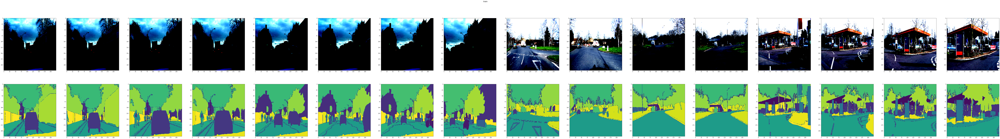

In [16]:
# PLOT a batch from validation dataloader
def plot_images(data, labels, name="train", cols = 16):
    fig, ax = plt.subplots(2, cols, figsize=(cols*10, 2*10))
    fig.suptitle(name, fontsize=16)
    for index in range(cols):
        ax[0, index].imshow(np.clip(data[index].permute(1, 2, 0).numpy(), 0, 1))
        ax[1, index].imshow(labels[index])

    plt.show()
plot_images(vis_batch[0], vis_batch[1])

# remove visualizatoin batch
del vis_batch

# FCN Model Architecture

FCN Model that uses VGG pretrained network for feature extraction and have skip connections in the upsampling stage.

In [17]:
import torch.nn as nn
from torchvision.models.vgg import VGG

class VGGNet(VGG):
    def __init__(self):
        super().__init__(self.conv_blocks())
        self.ranges =  ((0, 5), (5, 10), (10, 17), (17, 24), (24, 34))
        del self.classifier
    
    def conv_blocks(self):
        layers = []
        layers_ = [64, 64, 'M', 128, 128, 'M', 256, 256, 512, 'M', 512, 512, 512, 'M']
        in_channels = 3
        for v in layers_:
            if v == 'M':
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
            else:
                layers += [nn.Conv2d(in_channels, v, kernel_size=3, padding=1), nn.BatchNorm2d(v), nn.ReLU(inplace=True)]
                in_channels = v
        blocks = nn.ModuleList(layers)
        # print(blocks)
        return blocks

    def forward(self, x):
        output = {}
        for idx in range(len(self.ranges)):
            for layer in range(self.ranges[idx][0], self.ranges[idx][1]):
                # print(x.size())

                layer = self.features[layer]
                # print(layer)
                x = layer(x)
            output["x%d"%(idx+1)] = x

        return output

vgg=VGGNet()
# print(vgg)
temp_in = torch.rand(size=(16,3,224,224))
ovgg = vgg(temp_in)
print(ovgg['x1'].size(), ovgg['x2'].size(), ovgg['x3'].size(), ovgg['x4'].size(), ovgg['x5'].size())

torch.Size([16, 64, 224, 224]) torch.Size([16, 128, 112, 112]) torch.Size([16, 256, 56, 56]) torch.Size([16, 512, 28, 28]) torch.Size([16, 512, 14, 14])


In [18]:
from torchvision import models

class FCN(nn.Module):
    def __init__(self, pretrained_net):
        super().__init__()
        self.pretrained_net = pretrained_net
        self.relu    = nn.ReLU(inplace=True)
        self.deconv1 = nn.ConvTranspose2d(512, 512, kernel_size=3, stride=2, padding=1, dilation=1, output_padding=1)
        self.bn1     = nn.BatchNorm2d(512)
        self.deconv2 = nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, dilation=1, output_padding=1)
        self.bn2     = nn.BatchNorm2d(256)
        self.deconv3 = nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, dilation=1, output_padding=1)
        self.bn3     = nn.BatchNorm2d(128)
        self.deconv4 = nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, dilation=1, output_padding=1)
        self.bn4     = nn.BatchNorm2d(64)
        self.classifier = nn.Conv2d(64, len(CLASSES), kernel_size=1)

    def forward(self, x):
        output = self.pretrained_net(x)
        x5 = output['x5']  
        x4 = output['x4']  
        x3 = output['x3']  
        x2 = output['x2']  
        x1 = output['x1']  

        out = self.bn1(self.relu(self.deconv1(x5)))  
        # print(out.size(), x4.size(), x5.size())
        out = out + x4                               

        out = self.bn2(self.relu(self.deconv2(out))) 
        out = out + x3                               

        out = self.bn3(self.relu(self.deconv3(out))) 
        out = out + x2                               
        # print("x1: " , out.size())

        out = self.bn4(self.relu(self.deconv4(out))) 
        # print("out: " , out.size())
        out = out + x1       

        out = self.classifier(out)                   
        return out 

fcn = FCN(vgg)
# print(fcn)
temp_in = torch.rand(size=(16,3,224,224))
fcn(temp_in).size()

torch.Size([16, 32, 224, 224])

# Trainer Class
This class Does the main part of code which is training model, plot the training process and save model each n epochs.

I Defined `CrossEntropy` Loss and `Adam` Optimizer with learning rate 0.001 and 0.999 momentum.

Dp Each training step in `train_step` function and validation step in `val_step` function and whole trining process in 
`train` function.
 
### ⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇ U can See other Configurations BELOW ⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇⬇

In [22]:
#@title Some Configurations
EPOCHS = 150 #@param {type:"integer"}
device = 'cuda:0' if torch.cuda.is_available() else 'cpu' #@param
VERBOSE = 3 #@param [0, 1, 2, 3] {type:"raw"}
SAVE_PLOTS = True #@param {type:"boolean"}
VISUALIZE_PLOTS = True #@param {type:"boolean"}
SAVE_DIR = "/content/drive/MyDrive/fcn semantic/runs" #@param
MODEL_NAME = "FCN Semantic Segmentation" #@param
WEIGHTS = "/content/drive/MyDrive/fcn semantic/runs3/weights/FCN Semantic Segmentation-148.pt" #@param


/content/drive/MyDrive/fcn semantic/runs1
/content/drive/MyDrive/fcn semantic/runs2
/content/drive/MyDrive/fcn semantic/runs3
/content/drive/MyDrive/fcn semantic/runs4
/content/drive/MyDrive/fcn semantic/runs5
Loading state_dict from /content/drive/MyDrive/fcn semantic/runs3/weights/FCN Semantic Segmentation-148.pt for fine-tuning...
Model: FCN(
  (pretrained_net): VGGNet(
    (features): ModuleList(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): BatchNorm2d(128, eps=1e-05

Validation	0/150	1.193	19.639	68.484		: 100%|██████████| 7/7 [00:09<00:00,  1.41s/it]


---------------------------------------


Validation	1/150	0.782	24.334	78.696		: 100%|██████████| 7/7 [00:09<00:00,  1.40s/it]


---------------------------------------


Validation	2/150	0.718	24.906	79.470		: 100%|██████████| 7/7 [00:09<00:00,  1.40s/it]


---------------------------------------


Validation	3/150	0.836	21.994	75.221		: 100%|██████████| 7/7 [00:09<00:00,  1.39s/it]


---------------------------------------


Validation	4/150	0.739	25.211	79.947		: 100%|██████████| 7/7 [00:09<00:00,  1.41s/it]


---------------------------------------


Validation	5/150	0.745	25.001	79.063		: 100%|██████████| 7/7 [00:09<00:00,  1.40s/it]


---------------------------------------


Validation	6/150	0.751	26.389	79.426		: 100%|██████████| 7/7 [00:09<00:00,  1.42s/it]


---------------------------------------


Validation	7/150	0.736	24.005	79.414		: 100%|██████████| 7/7 [00:09<00:00,  1.42s/it]


---------------------------------------


Validation	8/150	0.756	22.471	79.033		: 100%|██████████| 7/7 [00:09<00:00,  1.42s/it]


---------------------------------------


Validation	9/150	0.987	20.684	75.480		: 100%|██████████| 7/7 [00:09<00:00,  1.42s/it]


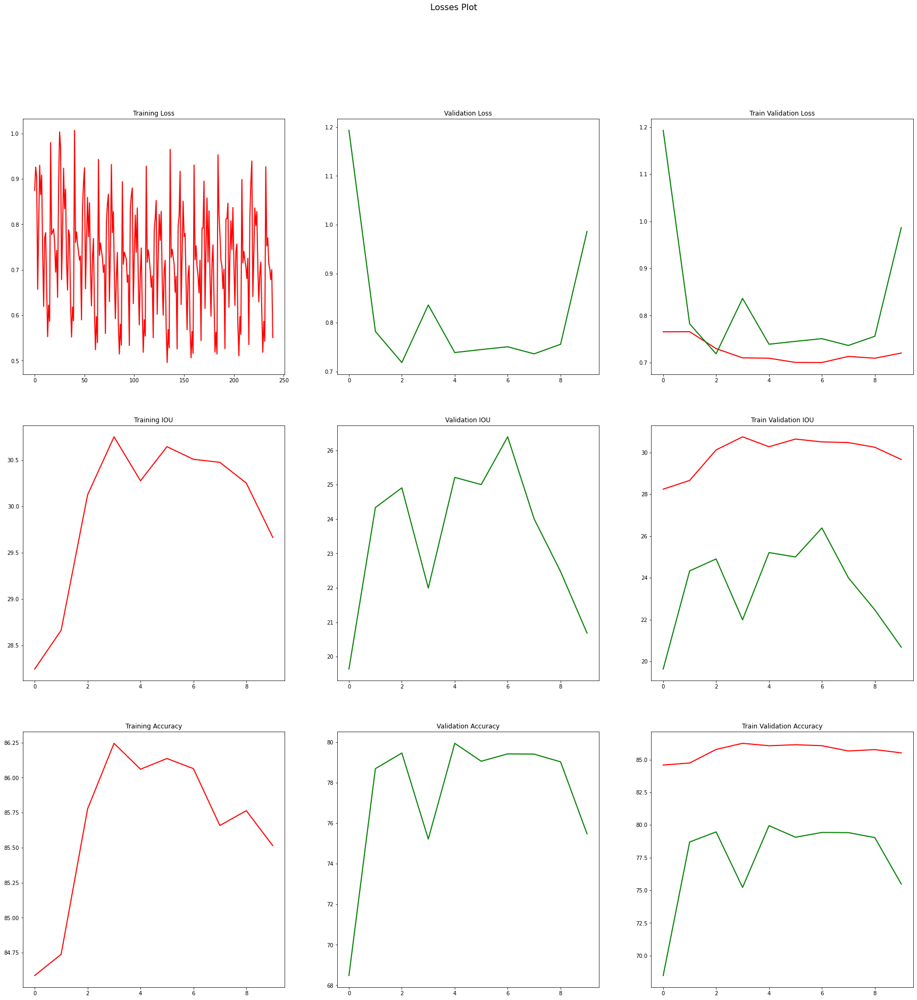

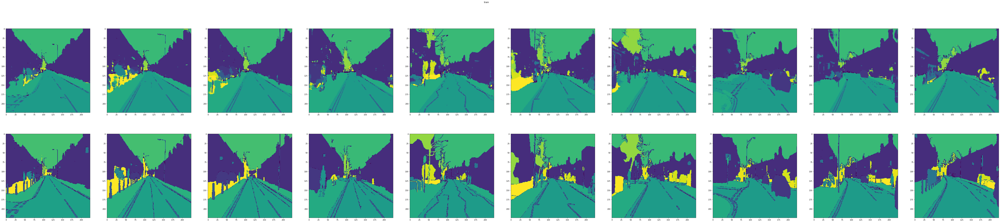

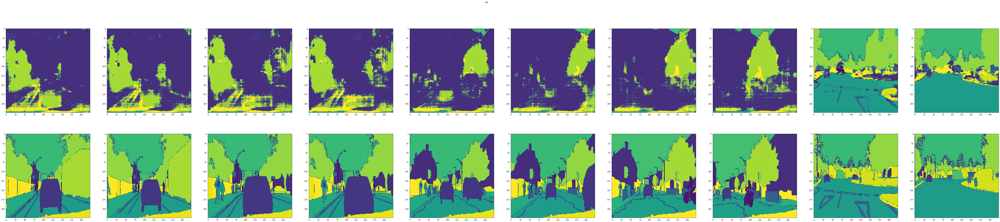


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	10/150	0.774	25.089	78.742		: 100%|██████████| 7/7 [00:10<00:00,  1.46s/it]


---------------------------------------


Validation	11/150	0.740	24.856	79.495		: 100%|██████████| 7/7 [00:10<00:00,  1.46s/it]


---------------------------------------


Validation	12/150	0.796	23.331	78.134		: 100%|██████████| 7/7 [00:10<00:00,  1.44s/it]


---------------------------------------


Validation	13/150	0.785	23.608	78.172		: 100%|██████████| 7/7 [00:09<00:00,  1.43s/it]


---------------------------------------


Validation	14/150	0.741	24.187	79.030		: 100%|██████████| 7/7 [00:10<00:00,  1.43s/it]


---------------------------------------


Validation	15/150	0.882	21.582	75.828		: 100%|██████████| 7/7 [00:10<00:00,  1.44s/it]


---------------------------------------


Validation	16/150	0.818	24.626	78.218		: 100%|██████████| 7/7 [00:10<00:00,  1.44s/it]


---------------------------------------


Validation	17/150	0.775	25.097	79.611		: 100%|██████████| 7/7 [00:10<00:00,  1.44s/it]


---------------------------------------


Validation	18/150	0.748	24.050	79.633		: 100%|██████████| 7/7 [00:10<00:00,  1.43s/it]


---------------------------------------


Validation	19/150	0.789	23.915	78.352		: 100%|██████████| 7/7 [00:10<00:00,  1.44s/it]


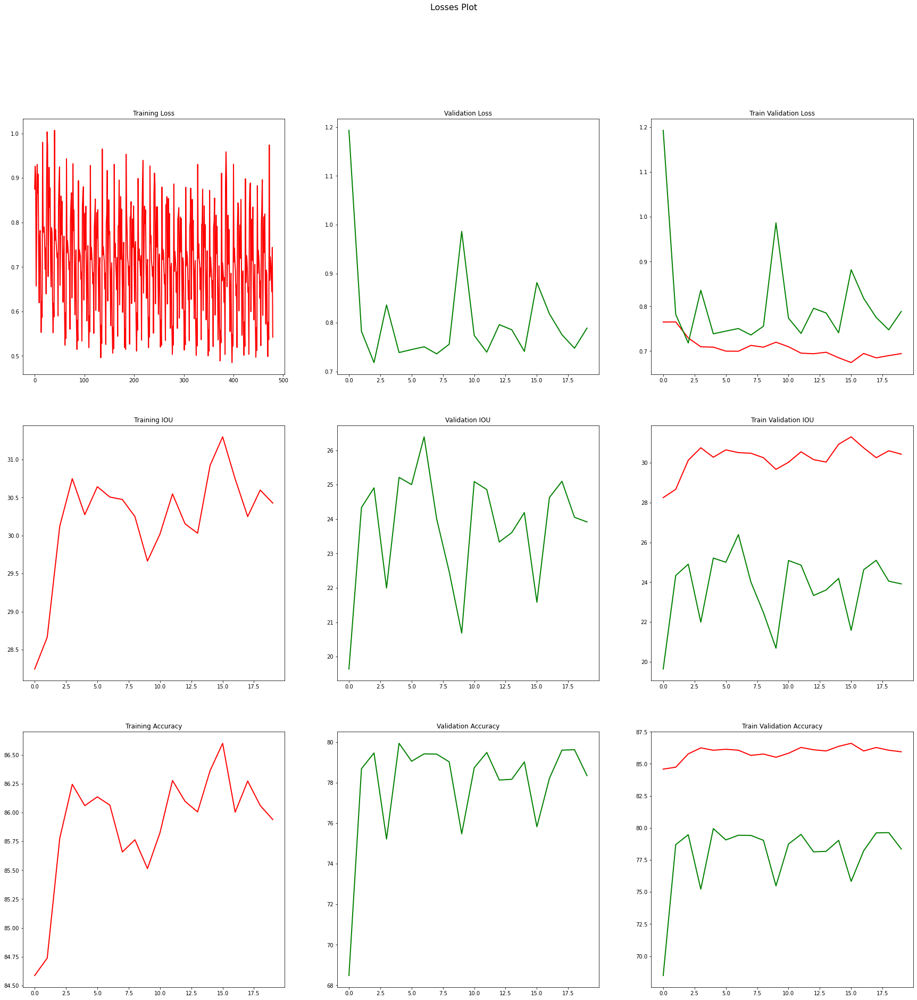

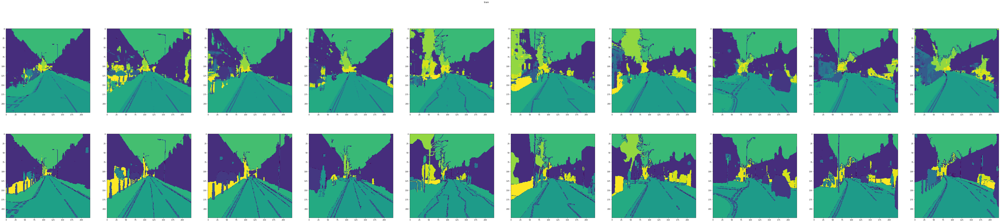

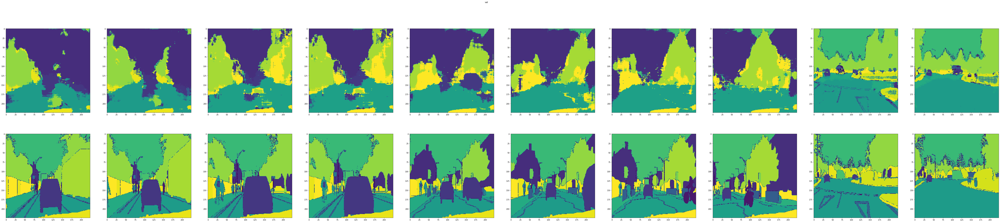


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	20/150	0.980	20.263	74.449		: 100%|██████████| 7/7 [00:10<00:00,  1.47s/it]


---------------------------------------


Validation	21/150	0.836	21.561	78.035		: 100%|██████████| 7/7 [00:10<00:00,  1.47s/it]


---------------------------------------


Validation	22/150	0.820	22.745	78.010		: 100%|██████████| 7/7 [00:10<00:00,  1.48s/it]


---------------------------------------


Validation	23/150	0.821	22.823	77.427		: 100%|██████████| 7/7 [00:10<00:00,  1.50s/it]


---------------------------------------


Validation	24/150	0.837	23.403	76.907		: 100%|██████████| 7/7 [00:10<00:00,  1.48s/it]


---------------------------------------


Validation	25/150	0.933	22.171	77.452		: 100%|██████████| 7/7 [00:10<00:00,  1.48s/it]


---------------------------------------


Validation	26/150	0.777	23.611	78.809		: 100%|██████████| 7/7 [00:10<00:00,  1.46s/it]


---------------------------------------


Validation	27/150	0.773	23.560	79.515		: 100%|██████████| 7/7 [00:10<00:00,  1.47s/it]


---------------------------------------


Validation	28/150	0.846	20.824	78.252		: 100%|██████████| 7/7 [00:10<00:00,  1.48s/it]


---------------------------------------


Validation	29/150	0.919	21.304	77.151		: 100%|██████████| 7/7 [00:10<00:00,  1.48s/it]


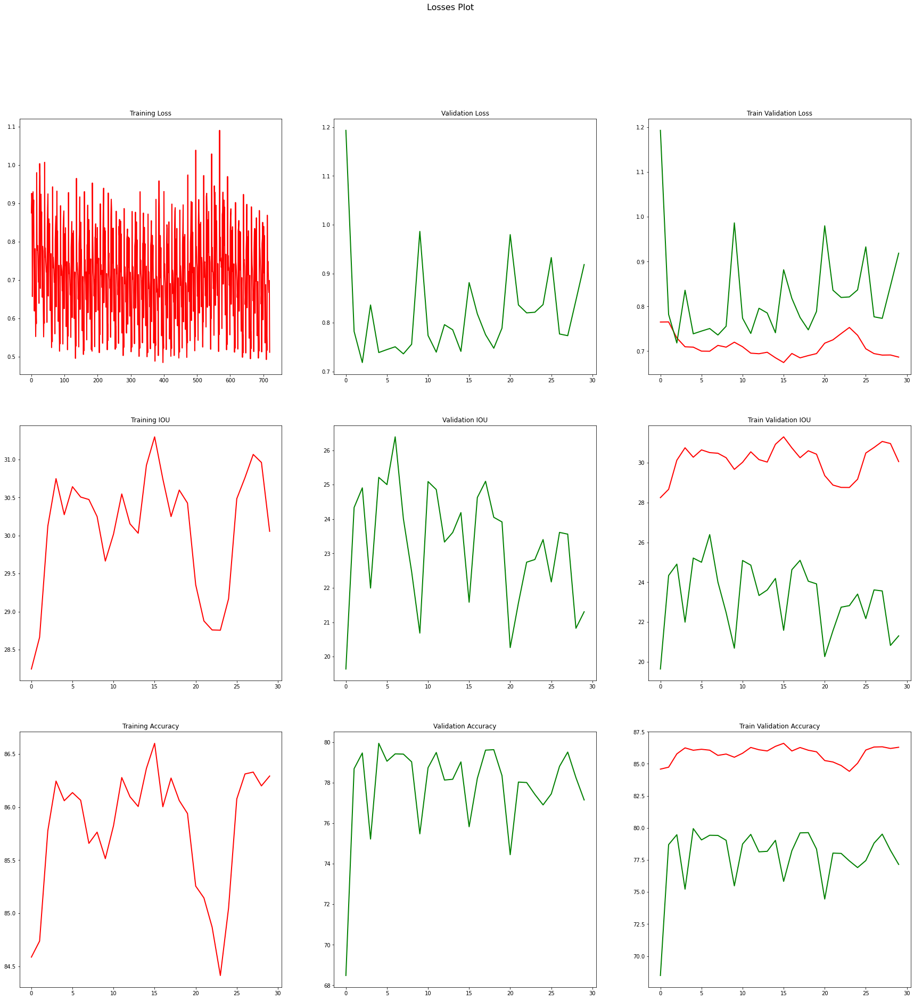

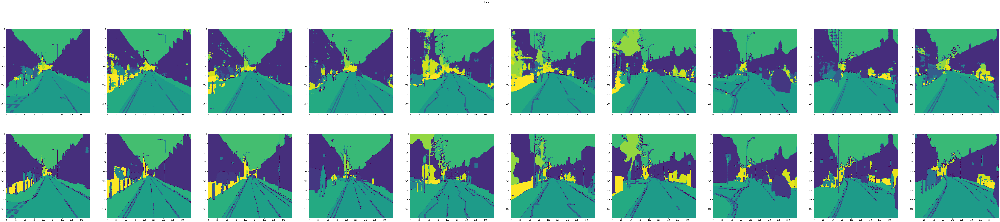

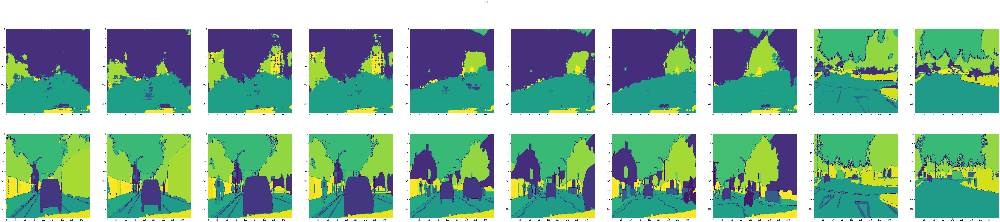


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	30/150	0.844	23.061	78.803		: 100%|██████████| 7/7 [00:10<00:00,  1.53s/it]


---------------------------------------


Validation	31/150	0.916	22.220	77.199		: 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


---------------------------------------


Validation	32/150	0.914	23.150	75.637		: 100%|██████████| 7/7 [00:10<00:00,  1.53s/it]


---------------------------------------


Validation	33/150	0.783	22.425	78.205		: 100%|██████████| 7/7 [00:10<00:00,  1.53s/it]


---------------------------------------


Validation	34/150	0.764	23.596	78.983		: 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


---------------------------------------


Validation	35/150	0.848	23.285	77.578		: 100%|██████████| 7/7 [00:10<00:00,  1.51s/it]


---------------------------------------


Validation	36/150	0.730	24.307	79.043		: 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


---------------------------------------


Validation	37/150	0.697	25.410	79.990		: 100%|██████████| 7/7 [00:10<00:00,  1.54s/it]


---------------------------------------


Validation	38/150	0.757	24.653	79.192		: 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


---------------------------------------


Validation	39/150	0.762	26.114	79.201		: 100%|██████████| 7/7 [00:10<00:00,  1.51s/it]


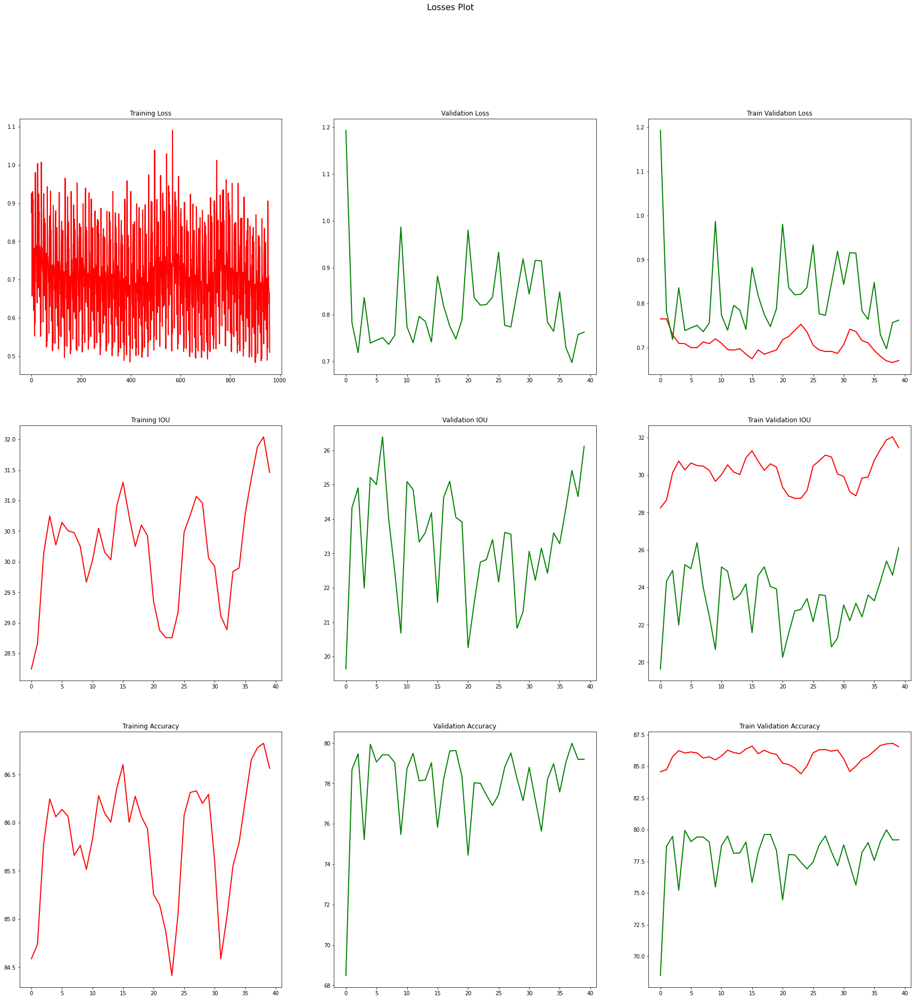

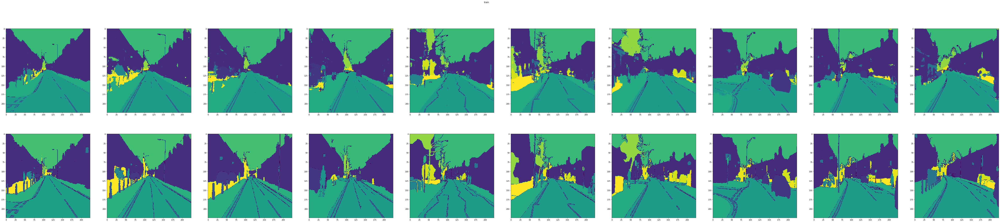

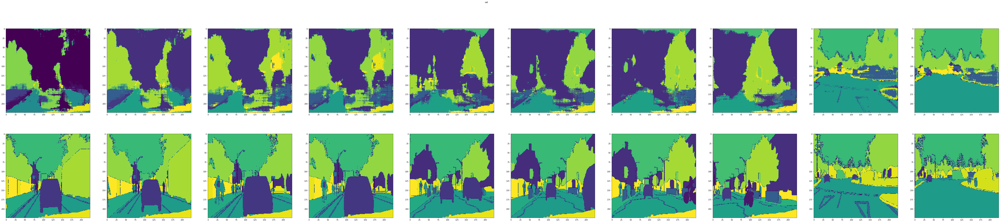


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	40/150	0.882	23.689	76.739		: 100%|██████████| 7/7 [00:10<00:00,  1.55s/it]


---------------------------------------


Validation	41/150	0.722	23.935	80.578		: 100%|██████████| 7/7 [00:10<00:00,  1.54s/it]


---------------------------------------


Validation	42/150	0.742	25.264	80.188		: 100%|██████████| 7/7 [00:10<00:00,  1.55s/it]


---------------------------------------


Validation	43/150	0.774	25.344	78.110		: 100%|██████████| 7/7 [00:10<00:00,  1.55s/it]


---------------------------------------


Validation	44/150	0.786	24.615	79.880		: 100%|██████████| 7/7 [00:10<00:00,  1.55s/it]


---------------------------------------


Validation	45/150	0.814	24.015	79.072		: 100%|██████████| 7/7 [00:10<00:00,  1.56s/it]


---------------------------------------


Validation	46/150	0.741	25.379	79.388		: 100%|██████████| 7/7 [00:10<00:00,  1.56s/it]


---------------------------------------


Validation	47/150	0.759	26.046	79.735		: 100%|██████████| 7/7 [00:10<00:00,  1.56s/it]


---------------------------------------


Validation	48/150	1.014	21.564	76.774		: 100%|██████████| 7/7 [00:10<00:00,  1.55s/it]


---------------------------------------


Validation	49/150	0.777	24.616	79.883		: 100%|██████████| 7/7 [00:10<00:00,  1.56s/it]


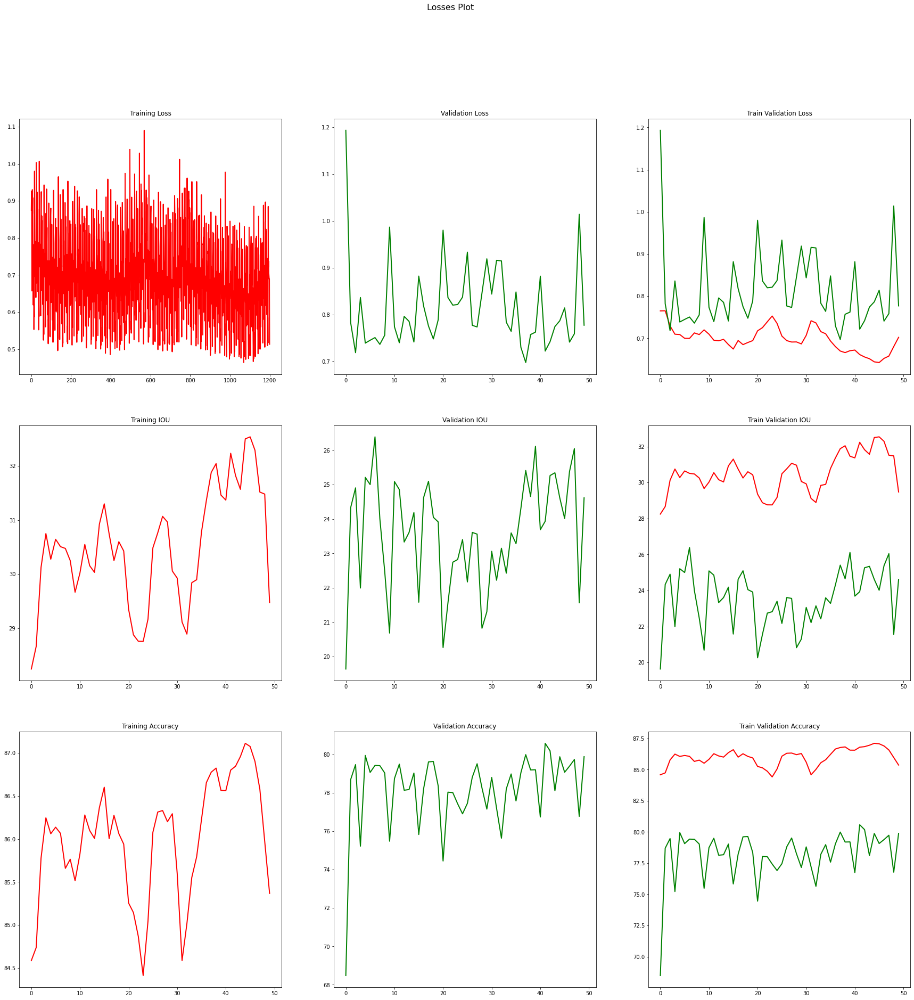

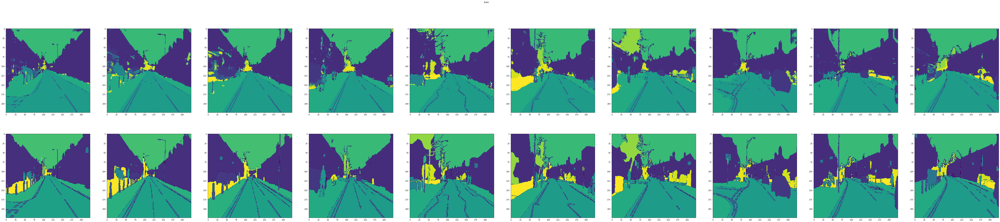

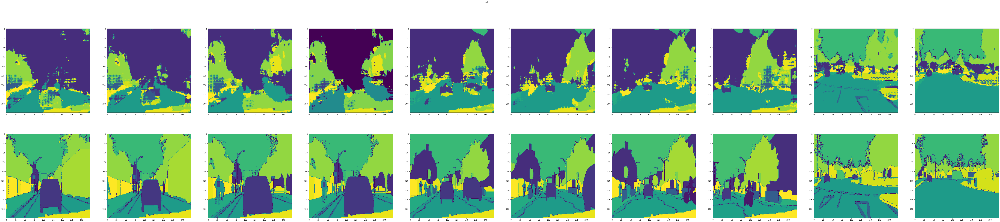


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	50/150	1.053	21.051	70.952		: 100%|██████████| 7/7 [00:11<00:00,  1.59s/it]


---------------------------------------


Validation	51/150	1.120	19.885	69.494		: 100%|██████████| 7/7 [00:11<00:00,  1.59s/it]


---------------------------------------


Validation	52/150	0.884	21.643	71.782		: 100%|██████████| 7/7 [00:11<00:00,  1.59s/it]


---------------------------------------


Validation	53/150	0.860	24.692	77.263		: 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]


---------------------------------------


Validation	54/150	0.792	24.405	78.724		: 100%|██████████| 7/7 [00:11<00:00,  1.59s/it]


---------------------------------------


Validation	55/150	0.726	24.021	79.754		: 100%|██████████| 7/7 [00:11<00:00,  1.60s/it]


---------------------------------------


Validation	56/150	0.805	25.656	79.381		: 100%|██████████| 7/7 [00:11<00:00,  1.60s/it]


---------------------------------------


Validation	57/150	0.699	25.128	80.173		: 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]


---------------------------------------


Validation	58/150	0.731	23.236	79.744		: 100%|██████████| 7/7 [00:11<00:00,  1.58s/it]


---------------------------------------


Validation	59/150	0.841	21.958	78.073		: 100%|██████████| 7/7 [00:11<00:00,  1.60s/it]


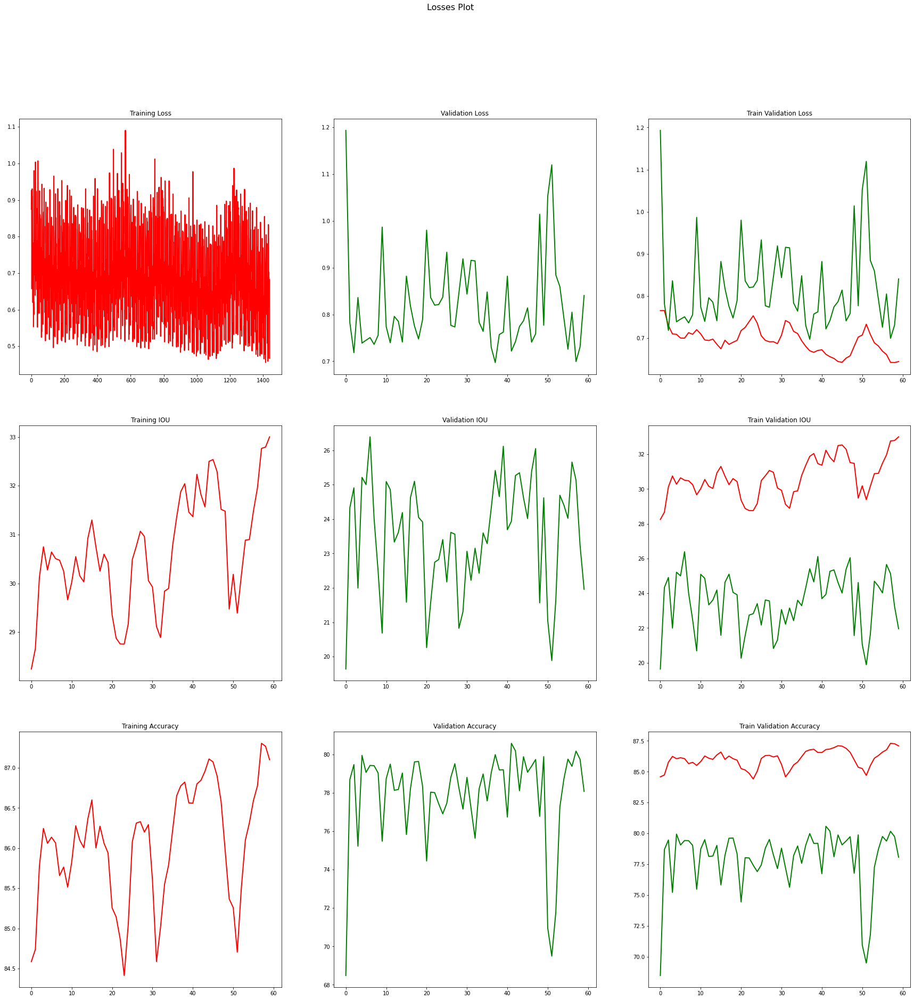

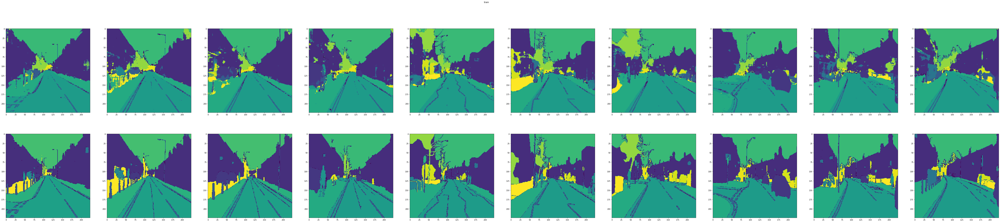

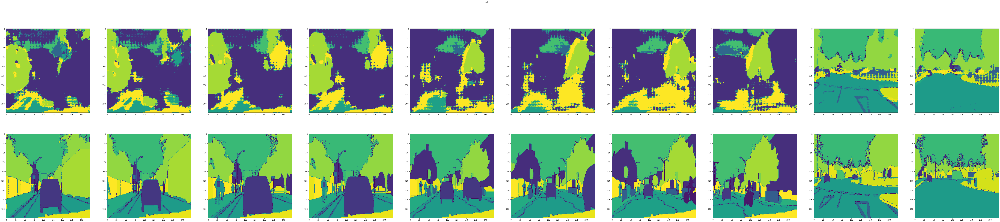


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	60/150	0.792	23.045	78.468		: 100%|██████████| 7/7 [00:11<00:00,  1.62s/it]


---------------------------------------


Validation	61/150	0.817	24.778	78.217		: 100%|██████████| 7/7 [00:11<00:00,  1.61s/it]


---------------------------------------


Validation	62/150	0.799	23.052	77.270		: 100%|██████████| 7/7 [00:11<00:00,  1.64s/it]


---------------------------------------


Validation	63/150	0.849	23.338	76.558		: 100%|██████████| 7/7 [00:11<00:00,  1.63s/it]


---------------------------------------


Validation	64/150	0.778	23.804	79.125		: 100%|██████████| 7/7 [00:11<00:00,  1.63s/it]


---------------------------------------


Validation	65/150	0.786	23.906	77.873		: 100%|██████████| 7/7 [00:11<00:00,  1.62s/it]


---------------------------------------


Validation	66/150	0.766	22.617	79.438		: 100%|██████████| 7/7 [00:11<00:00,  1.67s/it]


---------------------------------------


Validation	67/150	0.745	25.201	79.216		: 100%|██████████| 7/7 [00:11<00:00,  1.62s/it]


---------------------------------------


Validation	68/150	0.704	25.807	80.176		: 100%|██████████| 7/7 [00:11<00:00,  1.62s/it]


---------------------------------------


Validation	69/150	0.716	27.365	80.449		: 100%|██████████| 7/7 [00:11<00:00,  1.66s/it]


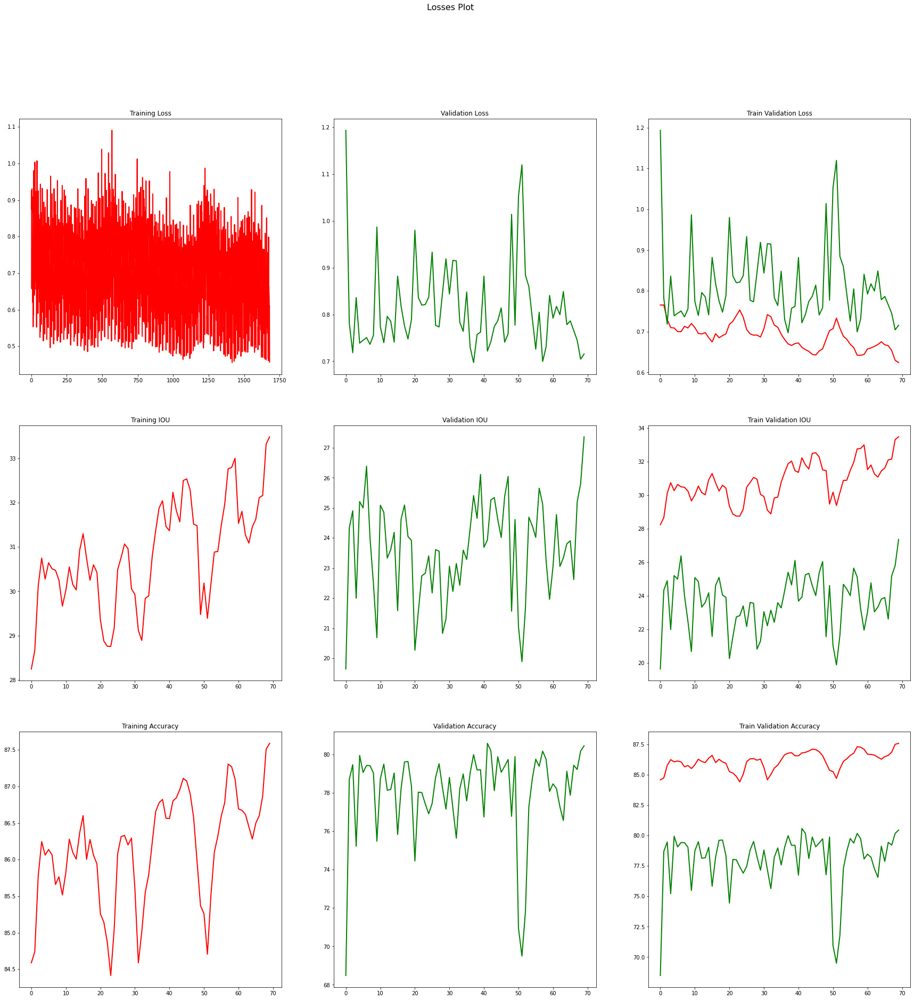

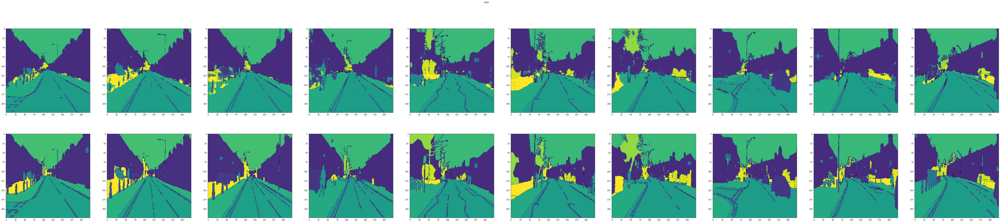

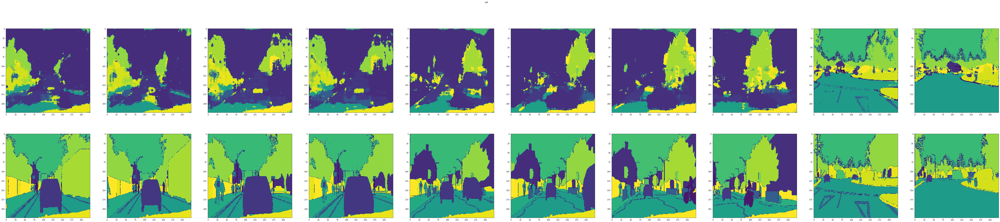


---		EPOCH	Loss	IOU	Accuracy
---------------------------------------


Validation	70/150	0.710	26.142	80.128		: 100%|██████████| 7/7 [00:11<00:00,  1.68s/it]


---------------------------------------


Validation	71/150	0.684	25.954	80.789		: 100%|██████████| 7/7 [00:11<00:00,  1.66s/it]


---------------------------------------


Validation	72/150	0.784	24.024	77.208		: 100%|██████████| 7/7 [00:11<00:00,  1.67s/it]


---------------------------------------


Train		73/150	0.673	30.629	85.671		:  21%|██        | 5/24 [00:09<00:35,  1.85s/it]

In [ ]:
import os
import time
import math
from copy import deepcopy
import os.path as osp
import shutil
from prettytable import PrettyTable
import json
from sklearn.metrics import auc

from tqdm import tqdm

import numpy as np
import torch
from torch.cuda import amp
# from torch.utils.tensorboard import SummaryWriter

class Trainer:
    # -----------------------------------------------INITIALIZE TRAINING-------------------------------------------------------------
    def __init__(self, device=device, epochs=10, batch_size=BATCH_SIZE, save_dir=SAVE_DIR, train_loader=train_data_loader, valid_loader=valid_data_loader, weights=WEIGHTS, verbose=VERBOSE, visualize_plots=VISUALIZE_PLOTS, save_plots=SAVE_PLOTS, model_name=MODEL_NAME, classes=CLASSES):
        self.device = device
        self.save_dir = save_dir
        self.batch_size = batch_size
        self.epochs = epochs
        self.use_ema = False
        self.model_name = model_name
        self.weights = weights
        self.visualize_plots = visualize_plots
        self.save_plots = save_plots
        # 0 == nothing || 1 == model architecture || 2 == print optimizer || 3 == model parameters
        self.verbose = verbose

        self.train_losses=[]
        self.val_losses=[]
        self.train_ious = []
        self.val_ious=[]
        self.train_accs = []
        self.val_accs=[]

        self.conf = {'Name' : self.model_name, 'Bacth_size' : self.batch_size, 'Max_iter_num' : '', 'Epochs' : self.epochs, 'Trained_epoch' : 0, 'Optimizer' : '', "Model" : '', 'Parameter_size' : ''}
        self.classes = classes
    
        temm=0
        tmp_save_dir = self.save_dir
        while osp.exists(tmp_save_dir):
            tmp_save_dir = self.save_dir
            temm+=1
            tmp_save_dir += (str(temm))
            print(tmp_save_dir)
        self.save_dir = tmp_save_dir
        os.makedirs(self.save_dir)
        del temm


        # get data loader
        self.train_loader, self.valid_loader = train_loader, valid_loader
        self.max_stepnum = len(self.train_loader)
        self.conf["Max_iter_num"] = self.max_stepnum
        
        # get model 
        self.model = self.get_model()
        if self.verbose > 2:
            self.count_parameters()

        # Get optimizer
        self.optimizer = self.get_optimizer()
    
        # tensorboard
        # self.tblogger = SummaryWriter(self.save_dir) 

# ----------------------------------------------------INITIALIZERS-------------------------------------------------------------------------
    # Get Model 
    def get_model(self):
        # Get Model Archutecture From Model Class.
        vgg_model = VGGNet()
        model = FCN(vgg_model).to(self.device)
        # finetune if pretrained model is set
        if self.weights:  
            print(f'Loading state_dict from {self.weights} for fine-tuning...')
            model.load_state_dict(torch.load(self.weights))
        # Log Model
        if self.verbose > 0:
            print('Model: {}'.format(model))
        self.conf["Model"] = str(model)
        return model

    def get_optimizer(self, optimizer="Adam", lr0=0.001, momentum=0.937):
        assert optimizer == 'SGD' or 'Adam', 'ERROR: unknown optimizer, use SGD defaulted'
        if optimizer == 'SGD':
            optim = torch.optim.SGD(self.model.parameters(), lr=lr0, momentum=momentum, nesterov=True)
        elif optimizer == 'Adam':
            optim = torch.optim.Adam(self.model.parameters(), lr=lr0, betas=(momentum, 0.999))

        if self.verbose > 1:
            print(f"{'optimizer:'} {type(optim).__name__}")
        self.conf['Optimizer'] = f"{'optimizer:'} {type(optim).__name__}"
        return optim

    # Loss Function Definition
    def compute_loss(self, images, targets):
        criterion = nn.CrossEntropyLoss() 
        loss = criterion(images, targets)
        return loss

    def count_parameters(self):
        table = PrettyTable(["Modules", "Parameters"])
        total_params = 0
        for name, parameter in self.model.named_parameters():
            if not parameter.requires_grad: continue
            params = parameter.numel()
            table.add_row([name, params])
            total_params+=params
        print(table)
        print(f"Total Trainable Params: {total_params}")
        self.conf["Parameter_size"] = total_params
# -------------------------------------------------------------------------------TRAINING PROCESS-----------------------------------------------
    @staticmethod
    def prepro_data(batch_data, device):
        images = batch_data[0].to(device)
        targets = batch_data[1].to(device) 
        return images, targets

    # Each Train Step
    def train_step(self, batch_data):
        images, targets = self.prepro_data(batch_data, self.device)
        # forward
        with amp.autocast(enabled=self.device != 'cpu'):
            preds = self.model(images)
            # preds = preds['out']
            loss = self.compute_loss(preds, targets)
        l2_lambda = 0.001
        l2_norm = sum(p.pow(2.0).sum() for p in self.model.parameters())

        loss = loss + l2_lambda * l2_norm
        # backward
        self.optimizer.zero_grad()
        self.scaler.scale(loss).backward()
        self.scaler.step(self.optimizer)
        self.scaler.update()
        
        _, predictions = torch.max(preds.data, 1)
        return loss.detach().cpu().numpy(), predictions.detach().cpu().numpy(), targets.detach().cpu().numpy()

    # Each Validation Step
    def val_step(self, batch_data):
        self.model.eval()
        images, targets = self.prepro_data(batch_data, self.device)

        # forward
        preds = self.model(images)
        # preds = preds['out']
        loss = self.compute_loss(preds, targets)
        _, predictions = torch.max(preds.data, 1)
        return loss.detach().cpu().numpy(), predictions.detach().cpu().numpy(), targets.detach().cpu().numpy()

    # Training Process
    def train(self):
        try:
            # training process prerequisite
            self.start_time = time.time()
            print('Start Training Process \nTime: {}'.format(time.ctime(self.start_time)))
            self.scaler = amp.GradScaler(enabled=self.device != 'cpu')
            self.best_loss = np.inf
            print("---\t\tEPOCH\tLoss\tIOU\tAccuracy")

            # Epoch Loop
            for self.epoch in range(0, self.epochs):
                try:
                    print("---------------------------------------")
                    self.conf["Trained_epoch"] = self.epoch
                    train_losses = []
                    val_losses = []
                    train_ious = []
                    val_ious = []
                    train_accs = []
                    val_accs = []

                    # Training loop
                    self.model.train(True)
                    pbar = enumerate(self.train_loader)
                    pbar = tqdm(pbar, total=self.max_stepnum)
                    for step, batch_data in pbar:
                        if step == self.max_stepnum - 2 :
                            self.train_loss, preds, targets = self.train_step(batch_data)
                            iou , acc = self.evaluation(preds, targets)
                        else : 
                            self.train_loss, predss, targetss = self.train_step(batch_data)
                            iou , acc = self.evaluation(predss, targetss)


                        # print("\nself.train_loss", self.train_loss)
                        # print("\niou", iou)
                        # print("\nacc", acc)
                        self.train_losses.append(self.train_loss)
                        self.train_ious.append(iou)
                        self.train_accs.append(acc)
                        
                        train_losses.append(self.train_loss)
                        train_ious.append(iou)
                        train_accs.append(acc)
                        pbar.set_description("Train\t\t%.0f/%.0f\t%.3f\t%.3f\t%.3f\t\t" % (self.epoch, self.epochs, np.mean(train_losses), np.mean(train_ious), np.mean(train_accs)))
                    del pbar

                    # Validation Loop
                    vbar = enumerate(self.valid_loader)
                    vbar = tqdm(vbar, total=len(self.valid_loader))
                    for step, batch_data in vbar:
                        if step == 0 :
                            self.val_loss, val_preds, val_targets = self.val_step(batch_data)
                            val_iou , val_acc = self.evaluation(val_preds, val_targets)
                        else : 
                            self.val_loss, val_predss, val_targetss = self.val_step(batch_data)
                            val_iou , val_acc = self.evaluation(val_predss, val_targetss)


                        self.val_losses.append(self.val_loss)
                        self.val_ious.append(val_iou)
                        self.val_accs.append(val_acc)

                        val_losses.append(self.val_loss)
                        val_ious.append(val_iou)
                        val_accs.append(val_acc)
                        vbar.set_description("Validation\t%.0f/%.0f\t%.3f\t%.3f\t%.3f\t\t" % (self.epoch, self.epochs, np.mean(val_losses), np.mean(val_ious), np.mean(val_accs)))
                    del vbar

                    if (self.epoch+1) % 10 == 0:
                        # PLot Losses
                        self.plot_loss()
                        self.plot_images(preds, targets, "train")
                        self.plot_images(val_preds, val_targets, "val")
                        print("\n---\t\tEPOCH\tLoss\tIOU\tAccuracy")


                    if self.val_loss < self.best_loss:
                        self.best_loss=self.val_loss

                except Exception as _:
                    print('ERROR in training steps.')
                    raise
                try:
                    self.save()
                except Exception as _:
                    print('ERROR in evaluate and save model.')
                    raise
        except Exception as _:
            print('ERROR in training loop or eval/save model.')
            raise
        finally:
            finish_time = time.time()
            print(f'\nTraining completed in {time.ctime(finish_time)} \nIts Done in: {(time.time() - self.start_time) / 3600:.3f} hours.') 
    

    # -------------------------------------------------------Training Callback after each epoch--------------------------
    def plot_loss(self, train_mean_size=1, val_mean_size=1):
        COLS=3
        ROWS=3
        LINE_WIDTH = 2
        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*10, ROWS*10))
        fig.suptitle("Losses Plot", fontsize=16)

        # train_mean_size = self.max_stepnum/self.batch_size
        ax[0][0].plot(np.arange(len(self.train_losses) / train_mean_size), np.mean(np.array(self.train_losses).reshape(-1, train_mean_size), axis=1), 'r',  label="training loss", linewidth=LINE_WIDTH)
        ax[0][0].set_title("Training Loss")

        val_mean_size = len(self.valid_loader)
        ax[0][1].plot(np.arange(len(self.val_losses) / val_mean_size), np.mean(np.array(self.val_losses).reshape(-1, val_mean_size), axis=1), 'g',  label="validation loss", linewidth=LINE_WIDTH)
        ax[0][1].set_title("Validation Loss")

        train_mean_size = self.max_stepnum
        ax[0][2].plot(np.arange(len(self.train_losses) / train_mean_size), np.mean(np.array(self.train_losses).reshape(-1, train_mean_size), axis=1), 'r',  label="training loss", linewidth=LINE_WIDTH)
        ax[0][2].plot(np.arange(len(self.val_losses) / val_mean_size), np.mean(np.array(self.val_losses).reshape(-1, val_mean_size), axis=1), 'g',  label="validation loss", linewidth=LINE_WIDTH)
        ax[0][2].set_title("Train Validation Loss")


        # train_mean_size = self.max_stepnum/self.batch_size
        ax[1][0].plot(np.arange(len(self.train_ious) / train_mean_size), np.mean(np.array(self.train_ious).reshape(-1, train_mean_size), axis=1), 'r',  label="training IOU", linewidth=LINE_WIDTH)
        ax[1][0].set_title("Training IOU")

        val_mean_size = len(self.valid_loader)
        ax[1][1].plot(np.arange(len(self.val_ious) / val_mean_size), np.mean(np.array(self.val_ious).reshape(-1, val_mean_size), axis=1), 'g',  label="validation IOU", linewidth=LINE_WIDTH)
        ax[1][1].set_title("Validation IOU")

        train_mean_size = self.max_stepnum
        ax[1][2].plot(np.arange(len(self.train_ious) / train_mean_size), np.mean(np.array(self.train_ious).reshape(-1, train_mean_size), axis=1), 'r',  label="training IOU", linewidth=LINE_WIDTH)
        ax[1][2].plot(np.arange(len(self.val_ious) / val_mean_size), np.mean(np.array(self.val_ious).reshape(-1, val_mean_size), axis=1), 'g',  label="validation IOU", linewidth=LINE_WIDTH)
        ax[1][2].set_title("Train Validation IOU")

            # train_mean_size = self.max_stepnum/self.batch_size
        ax[2][0].plot(np.arange(len(self.train_accs) / train_mean_size), np.mean(np.array(self.train_accs).reshape(-1, train_mean_size), axis=1), 'r',  label="training Accuracy", linewidth=LINE_WIDTH)
        ax[2][0].set_title("Training Accuracy")

        val_mean_size = len(self.valid_loader)
        ax[2][1].plot(np.arange(len(self.val_accs) / val_mean_size), np.mean(np.array(self.val_accs).reshape(-1, val_mean_size), axis=1), 'g',  label="validation Accuracy", linewidth=LINE_WIDTH)
        ax[2][1].set_title("Validation Accuracy")

        train_mean_size = self.max_stepnum
        ax[2][2].plot(np.arange(len(self.train_accs) / train_mean_size), np.mean(np.array(self.train_accs).reshape(-1, train_mean_size), axis=1), 'r',  label="training Accuracy", linewidth=LINE_WIDTH)
        ax[2][2].plot(np.arange(len(self.val_accs) / val_mean_size), np.mean(np.array(self.val_accs).reshape(-1, val_mean_size), axis=1), 'g',  label="validation Accuracy", linewidth=LINE_WIDTH)
        ax[2][2].set_title("Train Validation Accuracy")

        if self.save_plots:
            save_plot_dir = osp.join(self.save_dir, 'plots') 
            if not osp.exists(save_plot_dir):
                os.makedirs(save_plot_dir)
            plt.savefig("{}/epoch-{}-loss-plot.png".format(save_plot_dir, self.epoch)) 
        if self.visualize_plots:
            plt.show()
    
    def plot_images(self, preds, targets, name="train", cols = 10):
        fig, ax = plt.subplots(2, cols, figsize=(cols*10, 2*10))
        fig.suptitle(name, fontsize=12)
        for index in range(cols):
            ax[0, index].imshow(preds[index])
            ax[1, index].imshow(targets[index]) 
        if self.save_plots:
            save_plot_dir = osp.join(self.save_dir, 'images') 
            if not osp.exists(save_plot_dir):
                os.makedirs(save_plot_dir)
            plt.savefig("{}/epoch-{}-{}-image.png".format(save_plot_dir, self.epoch, name)) 
        if self.visualize_plots:
            plt.show()
        

    # -------------------------------------------------------save Model-------------------------------------------
    def save(self):
        # create config object
        conf = json.dumps(self.conf)
        f = open(self.save_dir + "/config.json", "w")
        f.write(conf)
        f.close()
        # save model
        save_ckpt_dir = osp.join(self.save_dir, 'weights')
        if not osp.exists(save_ckpt_dir):
            os.makedirs(save_ckpt_dir)
        filename = osp.join(save_ckpt_dir, self.model_name + "-" + str(self.epoch) + '.pt')
        torch.save(self.model.state_dict(), filename)
        if self.val_loss == self.best_loss:
            best_filename = osp.join(save_ckpt_dir, 'best_{}.pt'.format(self.model_name, self.epoch))
            if osp.exists(best_filename):
                os.remove(best_filename)
            shutil.copyfile(filename, best_filename)

    # -------------------------------------------------------Evaluate Model-------------------------------------------
    def calc_iou(self, pred, target):
        ious = []
        for cls in range(len(self.classes)):
            pred_inds = pred == cls
            target_inds = target == cls
            intersection = pred_inds[target_inds].sum()
            union = pred_inds.sum() + target_inds.sum() - intersection
            if union == 0:
                continue
            else:
                ious.append(float(intersection) / max(union, 1))
        return np.mean(ious) * 100


    def calc_acc(self, pred, target):
        correct = (pred == target).sum()
        total   = (target == target).sum()
        return (correct / total) * 100

    def evaluation(self, pred, target):
        return self.calc_iou(pred, target), self.calc_acc(pred, target)


trainer = Trainer(batch_size=BATCH_SIZE, device=device, epochs=EPOCHS, verbose=VERBOSE).train()
# Trainer(batch_size=32, device="cpu", epochs=50, verbose=0, weights="/content/runs/weights/best_SSL_epoch_45.pt").run("/content/data/faces/testing/s5/2.pgm", "/content/data/faces/testing/s7/4.pgm")